<a href="https://colab.research.google.com/github/ppyes3/UWL---Covid-ML-Project/blob/main/GroupProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



1.   Loading analysis packages
2.   Loading data
3.   Data at first sight
* 3.1.Data features` relationships 
* 3.2.Data types observation and defining
4.   Data preprocesing 
* 4.1. Duplicate records
* 4.2. Missing values
* 4.3. Negative values
* 4.4. Imputation
* 4.5. Convert Country_Region to Continent 
* 4.6. Convert Date to Month
* 4.7. Split column Target to columns ConfirmedCases and Fatalities
* 4.8. Creat columns Mortality_Rate and Infection_Rate
* 4.9. Get dummy variables 
5.   Linear regression
* 5.1. Linear regression with multiple features 
* 5.2. Polyniminal regression with multiple features 
6.   Regularisation
* 6.1. Lasso regressio
* 6.2. Ridge regressio
* 6.3. Elastic regression



















# **DRAFT** 
Week 8

# **1. Loading analysis packages**

In [ ]:
import numpy as np                                        
import pandas as pd                                       
import matplotlib.pyplot as plt                           
import seaborn as sns  
import plotly.graph_objects as go 
import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot
                                
%matplotlib inline 

# **2. Loading data**

In [ ]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

# extra data https://github.com/CSSEGISandData?tab=repositories

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.



# **3. Data at first sight**

In [ ]:
train.head()

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
0,1,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-23,ConfirmedCases,0
1,2,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-23,Fatalities,0
2,3,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-24,ConfirmedCases,0
3,4,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-24,Fatalities,0
4,5,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-25,ConfirmedCases,0


In [ ]:
test.head()

,ForecastId,County,Province_State,Country_Region,Population,Weight,Date,Target
0,1,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-27,ConfirmedCases
1,2,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-27,Fatalities
2,3,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-28,ConfirmedCases
3,4,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-28,Fatalities
4,5,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-29,ConfirmedCases


In [ ]:
print("Train dataset (rows, cols):",train.shape, "\nTest dataset (rows, cols):",test.shape)

Train dataset (rows, cols): (969640, 9) 
Test dataset (rows, cols): (311670, 8)


# **3.1. Data features` relationships**

In [ ]:
# the ratio between Confirmed cases and Fatalities 
fig = px.pie(train, values='TargetValue', names='Target')
fig.show()


In [ ]:
# Affected people by countries 
fig = px.pie(train, values='TargetValue', names='Country_Region')
fig.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



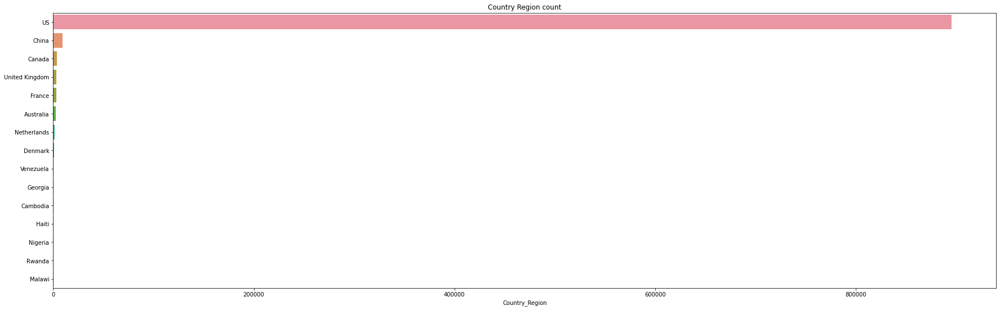

In [ ]:
plt.figure(figsize=(30,9))
Country_Region_plot=train.Country_Region.value_counts().head(15)
sns.barplot(Country_Region_plot, Country_Region_plot.index)
plt.title('Country Region count');

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



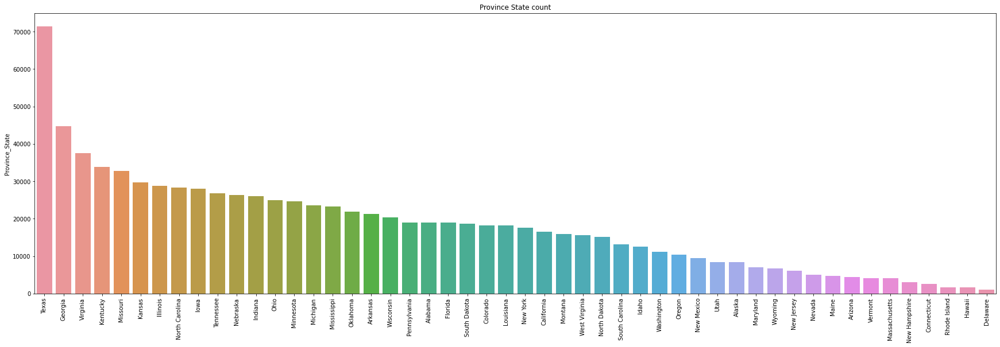

In [ ]:
plt.figure(figsize=(30,9))
Province_State_plot=train.Province_State.value_counts().head(50)
sns.barplot(Province_State_plot.index,Province_State_plot)
plt.xticks(rotation=90)
plt.title('Province State count');

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0.5, 1.0, 'County count')

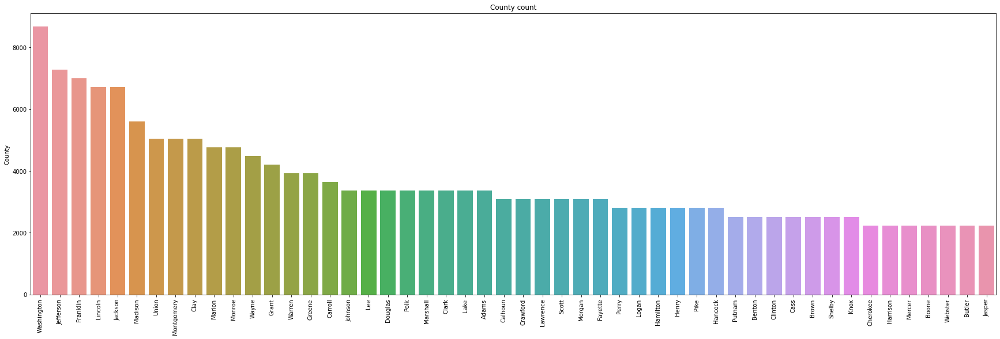

In [ ]:
plt.figure(figsize=(30,9))
county_plot=train.County.value_counts().head(50)
sns.barplot(county_plot.index,county_plot)
plt.xticks(rotation=90)
plt.title('County count')

In [ ]:
last_date = train.Date.max()
df_countries = train[train['Date']==last_date]
df_countries = df_countries.groupby('Country_Region', as_index=False)['TargetValue'].sum()
df_countries = df_countries.nlargest(10,'TargetValue')
df_trend = train.groupby(['Date','Country_Region'], as_index=False)['TargetValue'].sum()
df_trend = df_trend.merge(df_countries, on='Country_Region')
df_trend.rename(columns={'Country_Region':'Country', 'TargetValue_x':'Cases'}, inplace=True)
df_trend.head()

,Date,Country,Cases,TargetValue_y
0,2020-01-23,Bangladesh,0,3227
1,2020-01-24,Bangladesh,0,3227
2,2020-01-25,Bangladesh,0,3227
3,2020-01-26,Bangladesh,0,3227
4,2020-01-27,Bangladesh,0,3227


In [ ]:
px.line(df_trend, x='Date', y='Cases', 
        color='Country',
        title='Top 10 affected countries by COVID19 Total n/ in the period 23 Jan - 10 June 2020')

# **3.2. Data types observation and defining**

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 969640 entries, 0 to 969639
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Id              969640 non-null  int64  
 1   County          880040 non-null  object 
 2   Province_State  917280 non-null  object 
 3   Country_Region  969640 non-null  object 
 4   Population      969640 non-null  int64  
 5   Weight          969640 non-null  float64
 6   Date            969640 non-null  object 
 7   Target          969640 non-null  object 
 8   TargetValue     969640 non-null  int64  
dtypes: float64(1), int64(3), object(5)
memory usage: 66.6+ MB


Observation
*   with the info() method, we see that the data type is integer, float and object
*   No null values are present in the dataset by info().

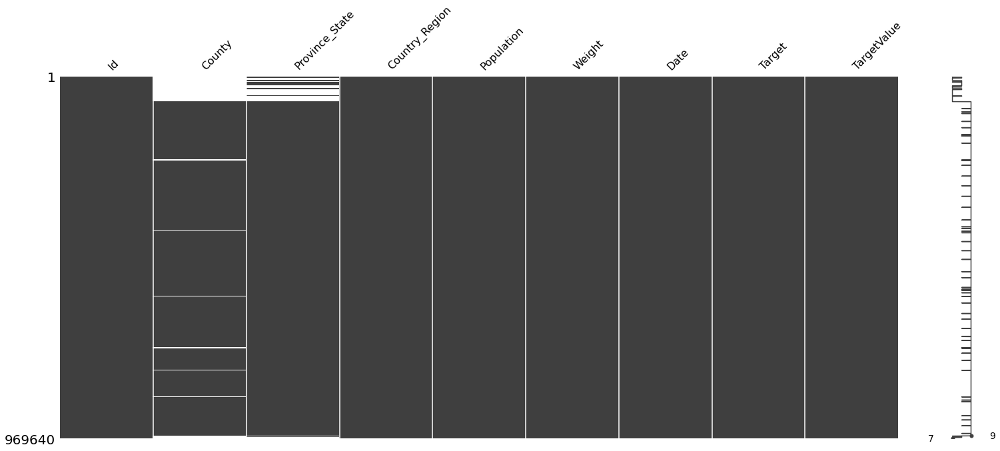

In [ ]:
# Visualize missing values
import missingno as msno 
%matplotlib inline
msno.matrix(train)

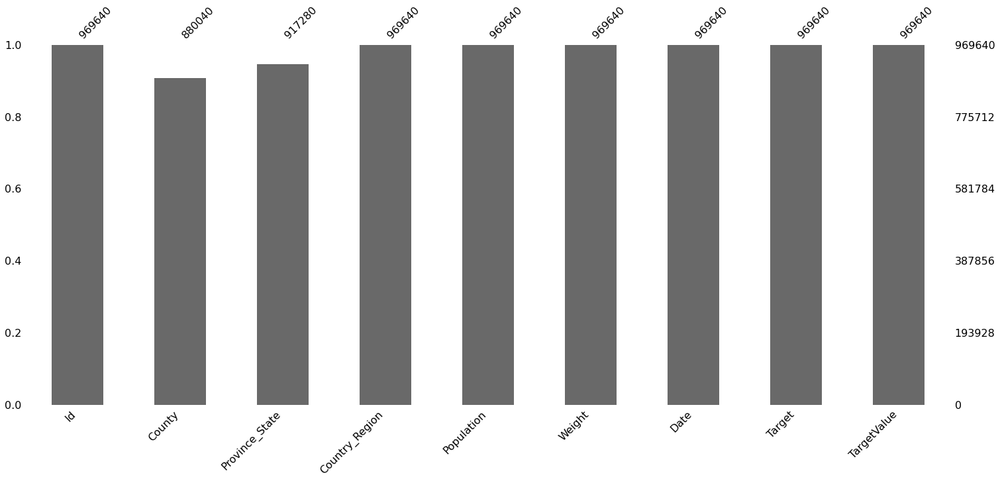

In [ ]:
msno.bar(train);

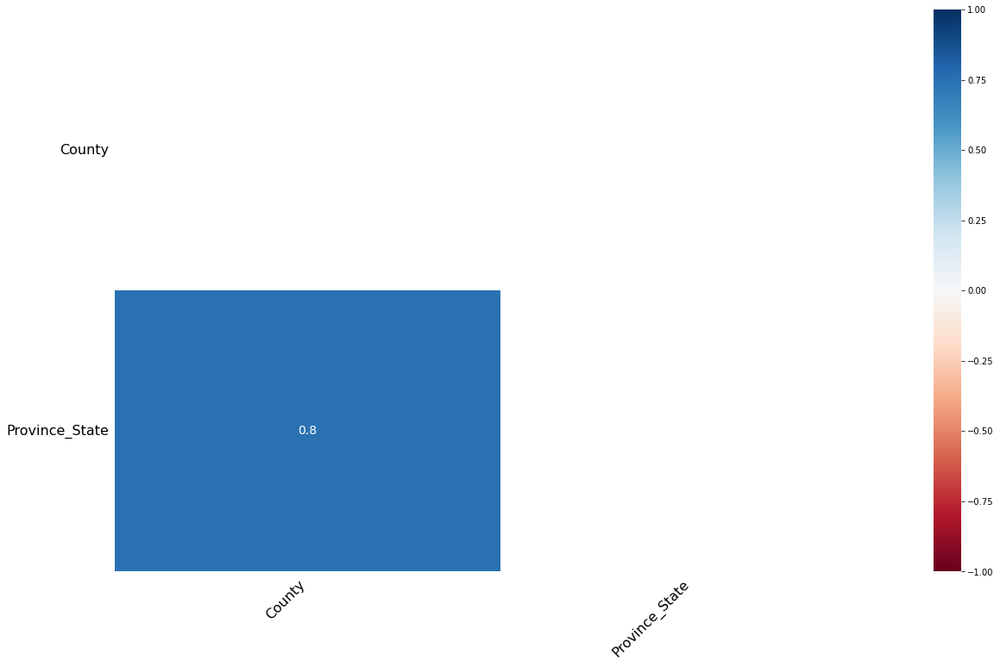

In [ ]:
msno.heatmap(train)

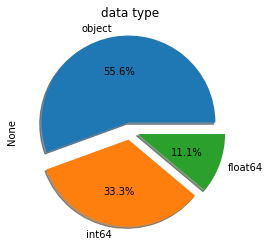

In [ ]:
train.dtypes.value_counts().plot.pie(explode=[0.1,0.1,0.1],autopct='%1.1f%%',shadow=True)
plt.title('data type');

In [ ]:
data = []
for feature in train.columns:
    # Defining the role
    if feature == 'Target':
        use = 'target'
    elif feature == 'Id':
        use = 'id'
    else:
        use = 'input'
         
    # Defining the type
    if feature == 'TargetValue' or feature == 'Population':
        type = 'integer'
    elif feature == 'Weight':
        type = 'real'
    elif feature == 'Date':
        type = "time"
    else:
        type = 'categorical'
        
    # Initialize preserve to True for all variables except for id
    preserve = True
    if feature == 'id':
        preserve = False
    
    # Defining the data type 
    dtype = train[feature].dtype
    
    # Creating a Dict that contains all the metadata for the variable
    feature_dictionary = {
        'varname': feature,
        'use': use,
        'type': type,
        'preserve': preserve,
        'dtype': dtype,
    }
    data.append(feature_dictionary)
    
meta = pd.DataFrame(data, columns=['varname', 'use', 'type', 'preserve', 'dtype'])
meta.set_index('varname', inplace=True)
meta

,use,type,preserve,dtype
varname,,,,
Id,id,categorical,True,int64
County,input,categorical,True,object
Province_State,input,categorical,True,object
Country_Region,input,categorical,True,object
Population,input,integer,True,int64
Weight,input,real,True,float64
Date,input,time,True,object
Target,target,categorical,True,object
TargetValue,input,integer,True,int64


In [ ]:
pd.DataFrame({'count' : meta.groupby(['use', 'type'])['use'].size()}).reset_index()

,use,type,count
0,id,categorical,1
1,input,categorical,3
2,input,integer,2
3,input,real,1
4,input,time,1
5,target,categorical,1


In [ ]:
train.describe(include='all')

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
count,969640.000000,880040,917280,969640,9.696400e+05,969640.000000,969640,969640,969640.000000
unique,NaN,1840,133,187,NaN,NaN,140,2,NaN
top,NaN,Washington,Texas,US,NaN,NaN,2020-05-01,Fatalities,NaN
freq,NaN,8680,71400,895440,NaN,NaN,6926,484820,NaN
mean,484820.500000,NaN,NaN,NaN,2.720127e+06,0.530870,NaN,NaN,12.563518
std,279911.101847,NaN,NaN,NaN,3.477771e+07,0.451909,NaN,NaN,302.524795
min,1.000000,NaN,NaN,NaN,8.600000e+01,0.047491,NaN,NaN,-10034.000000
25%,242410.750000,NaN,NaN,NaN,1.213300e+04,0.096838,NaN,NaN,0.000000
50%,484820.500000,NaN,NaN,NaN,3.053100e+04,0.349413,NaN,NaN,0.000000
75%,727230.250000,NaN,NaN,NaN,1.056120e+05,0.968379,NaN,NaN,0.000000


Observation
*   187 coutries 
*   Column Target contains only ConfirmedCases and Fatalities




# **4. Data preprocessing**

# **4.1. Duplicate records**

In [ ]:
print("Train dataset (rows, cols):",train.shape, "\nTest dataset (rows, cols):",test.shape)

Train dataset (rows, cols): (969640, 9) 
Test dataset (rows, cols): (311670, 8)


In [ ]:
train.drop_duplicates()
train.shape

(969640, 9)

In [ ]:
test.drop_duplicates()
test.shape

(311670, 8)

# **4.2. Missing values**

In [ ]:
train = train.drop(['County', 'Province_State'], axis = 1)
train.head()

,Id,Country_Region,Population,Weight,Date,Target,TargetValue
0,1,Afghanistan,27657145,0.058359,2020-01-23,ConfirmedCases,0
1,2,Afghanistan,27657145,0.583587,2020-01-23,Fatalities,0
2,3,Afghanistan,27657145,0.058359,2020-01-24,ConfirmedCases,0
3,4,Afghanistan,27657145,0.583587,2020-01-24,Fatalities,0
4,5,Afghanistan,27657145,0.058359,2020-01-25,ConfirmedCases,0


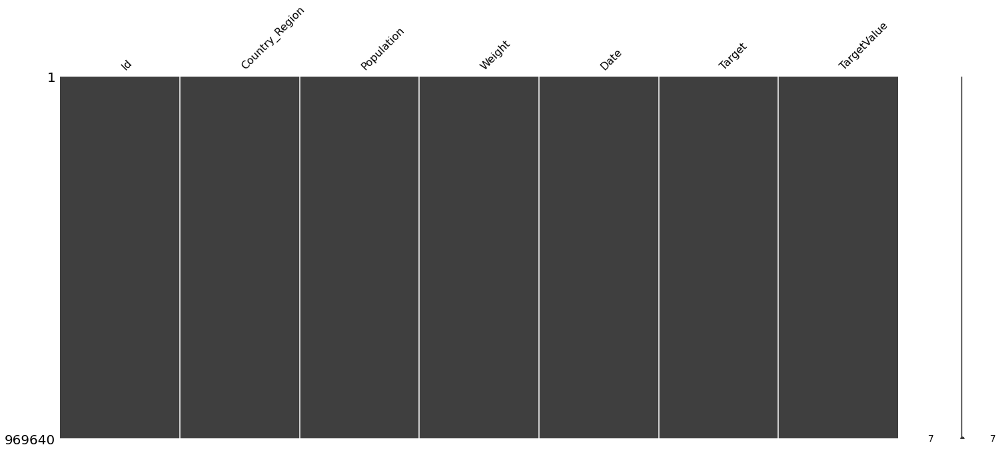

In [ ]:
 # Visualize missing values
import missingno as msno 
%matplotlib inline
msno.matrix(train)

# **4.3. Negative values**

In [ ]:
train = train.sort_values(['TargetValue'])
train.head()

,Id,Country_Region,Population,Weight,Date,Target,TargetValue
63464,63465,Spain,46438422,0.056646,2020-04-24,ConfirmedCases,-10034
35826,35827,France,66710000,0.055507,2020-06-04,ConfirmedCases,-2850
35754,35755,France,66710000,0.055507,2020-04-29,ConfirmedCases,-2512
35740,35741,France,66710000,0.055507,2020-04-22,ConfirmedCases,-2206
63527,63528,Spain,46438422,0.566455,2020-05-25,Fatalities,-1918


In [ ]:
print ('Negative values: {}'.format(np.sum((train['TargetValue']  < 0).values.ravel())))

Negative values: 4587


In [ ]:
# replace negative values with median because : ........................
# train['TargetValue'] = train.groupby('TargetValue')['TargetValue'].transform(lambda x: np.where(x < 0, x.mean(), x))
# train[train['TargetValue'] < 0] = train['TargetValue'].median()

# **4.4. Imputation**

In [ ]:
def _impute_missing_data(data):
    return data.replace(-1, np.nan)

train = _impute_missing_data(train)

In [ ]:
from sklearn.impute import SimpleImputer

mean_imp = SimpleImputer(missing_values=np.nan, strategy='mean')
train['TargetValue'] = mean_imp.fit_transform(train[['TargetValue']]).ravel()

In [ ]:
# !!!!!!!!!!!!!!!!!
print ('Negative values: {}'.format(np.sum((train['TargetValue']  < 0).values.ravel())))

Negative values: 1085


# **4.5. Convert Country_Region to Continent**

In [ ]:
 !pip install pycountry_convert

In [ ]:
import pycountry_convert as pc

def convert(row):
  cn_code = pc.country_name_to_country_alpha2(row.country, cn_name_format = 'default')
  conti_code = pc.country_alpha2_to_continent_code(cn_code)
  return conti_code

In [ ]:
# https://en.wikipedia.org/wiki/List_of_sovereign_states
train = train.replace(['Burma'], 'Myanmar')
train = train.replace(['Congo (Brazzaville)'], 'Republic of the Congo')
train = train.replace(['Congo (Kinshasa)'], 'Democratic Republic of the Congo')
train = train.replace(["Cote d'Ivoire"], 'Ivory Coast')
train = train[train['Country_Region'] != 'Diamond Princess']
train = train[train['Country_Region'] != 'Holy See'] 
train = train.replace(['Korea, South'], 'Korea, Republic of')
train = train[train['Country_Region'] != 'Kosovo']
train = train[train['Country_Region'] != 'MS Zaandam'] # cruise
train = train.replace(['Taiwan*'], 'China')  # China instead Peoples Republic of China
train = train[train['Country_Region'] != 'Timor-Leste']  #TL couldnt be found

In [ ]:
# train =  train.rename(columns={'Country_Region':'country'})
# train

In [ ]:
# train['country'] = train.apply(convert, axis = 1)
# train

In [ ]:
# continent_names = {'AS': 'Asia',
#                    'SA': 'South America',
#                    'AS': 'Asia',
#                    'OC': 'Oceania',
#                    'EU': 'Europe',
#                    'NA': 'North America',
#                    'AF': 'Africa'}

# train['Continent'] = train['Continent'].map(countinent_names)

In [ ]:
# # https://geopandas.org/en/stable/docs/user_guide/mapping.html
# !pip install geopandas

In [ ]:
# import geopandas
# world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))
# world.plot()
# https://towardsdatascience.com/using-python-to-create-a-world-map-from-a-list-of-country-names-cd7480d03b10
# https://www.bing.com/videos/search?q=geopandas.read_file(&&view=detail&mid=408D6977AC106719F144408D6977AC106719F144&&FORM=VRDGAR&ru=%2Fvideos%2Fsearch%3Fq%3Dgeopandas.read_file(%26FORM%3DHDRSC4
# https://www.youtube.com/watch?v=vLEA8dCfusQ&t=84s

# **Convert Date to Month**

In [ ]:
train = train.sort_values(["Date"])
train['Date'].unique()

array(['2020-01-23', '2020-01-24', '2020-01-25', '2020-01-26',
       '2020-01-27', '2020-01-28', '2020-01-29', '2020-01-30',
       '2020-01-31', '2020-02-01', '2020-02-02', '2020-02-03',
       '2020-02-04', '2020-02-05', '2020-02-06', '2020-02-07',
       '2020-02-08', '2020-02-09', '2020-02-10', '2020-02-11',
       '2020-02-12', '2020-02-13', '2020-02-14', '2020-02-15',
       '2020-02-16', '2020-02-17', '2020-02-18', '2020-02-19',
       '2020-02-20', '2020-02-21', '2020-02-22', '2020-02-23',
       '2020-02-24', '2020-02-25', '2020-02-26', '2020-02-27',
       '2020-02-28', '2020-02-29', '2020-03-01', '2020-03-02',
       '2020-03-03', '2020-03-04', '2020-03-05', '2020-03-06',
       '2020-03-07', '2020-03-08', '2020-03-09', '2020-03-10',
       '2020-03-11', '2020-03-12', '2020-03-13', '2020-03-14',
       '2020-03-15', '2020-03-16', '2020-03-17', '2020-03-18',
       '2020-03-19', '2020-03-20', '2020-03-21', '2020-03-22',
       '2020-03-23', '2020-03-24', '2020-03-25', '2020-

In [ ]:
# turn period in months 
# 1. Convert str Date to date format
train['Date'] = pd.to_datetime(train['Date'])
train.head()

,Id,Country_Region,Population,Weight,Date,Target,TargetValue
471521,471522,US,184945,0.824551,2020-01-23,Fatalities,0.0
81761,81762,US,226486,0.811001,2020-01-23,Fatalities,0.0
81760,81761,US,226486,0.081100,2020-01-23,ConfirmedCases,0.0
444361,444362,US,25008,0.987460,2020-01-23,Fatalities,0.0
444360,444361,US,25008,0.098746,2020-01-23,ConfirmedCases,0.0


In [ ]:
# 2. Creat column Month 
train['Month'] = train['Date'].dt.month
train.head()

,Id,Country_Region,Population,Weight,Date,Target,TargetValue,Month
471521,471522,US,184945,0.824551,2020-01-23,Fatalities,0.0,1
81761,81762,US,226486,0.811001,2020-01-23,Fatalities,0.0,1
81760,81761,US,226486,0.081100,2020-01-23,ConfirmedCases,0.0,1
444361,444362,US,25008,0.987460,2020-01-23,Fatalities,0.0,1
444360,444361,US,25008,0.098746,2020-01-23,ConfirmedCases,0.0,1


In [ ]:
train['Month'].unique()

array([1, 2, 3, 4, 5, 6])

In [ ]:
#  month_names = {1: 'January',
#                 2: 'February',
#                 3: 'March',
#                 4: 'April',
#                 5: 'May',
#                 6: 'June'}

# train['Month'] = train['Month'].map(month_names)

In [ ]:
train = train.drop(['Date'], axis=1)
train.head()

,Id,Country_Region,Population,Weight,Target,TargetValue,Month
471521,471522,US,184945,0.824551,Fatalities,0.0,1
81761,81762,US,226486,0.811001,Fatalities,0.0,1
81760,81761,US,226486,0.081100,ConfirmedCases,0.0,1
444361,444362,US,25008,0.987460,Fatalities,0.0,1
444360,444361,US,25008,0.098746,ConfirmedCases,0.0,1


# **Split column Target to columns ConfirmedCases and Fatalities**

In [ ]:
# Create column Confirmed Cases
# compare both datatframes: train_fatalities and train_confirmed_cases
train_confirmed_cases =  train.groupby(['Target']).get_group('ConfirmedCases').reset_index()
train_confirmed_cases.head()

,index,Id,Country_Region,Population,Weight,Target,TargetValue,Month
0,81760,81761,US,226486,0.081100,ConfirmedCases,0.0,1
1,444360,444361,US,25008,0.098746,ConfirmedCases,0.0,1
2,40320,40321,India,1295210000,0.047660,ConfirmedCases,0.0,1
3,746480,746481,US,4351,0.119355,ConfirmedCases,0.0,1
4,811720,811721,US,20837,0.100558,ConfirmedCases,0.0,1


In [ ]:
# Create column Fatalities 
train_fatalities =  train.groupby(['Target']).get_group('Fatalities').reset_index()
train_fatalities.head()

,index,Id,Country_Region,Population,Weight,Target,TargetValue,Month
0,471521,471522,US,184945,0.824551,Fatalities,0.0,1
1,81761,81762,US,226486,0.811001,Fatalities,0.0,1
2,444361,444362,US,25008,0.987460,Fatalities,0.0,1
3,641761,641762,US,5745,1.155233,Fatalities,0.0,1
4,663601,663602,US,44731,0.933842,Fatalities,0.0,1


In [ ]:
# compare both datatframes: train_confirmed_cases and train_fatalities 

In [ ]:
train_confirmed_cases =  train_confirmed_cases.rename(columns={'TargetValue': 'Confirmed_Cases'})
train_confirmed_cases.head()

,index,Id,Country_Region,Population,Weight,Target,Confirmed_Cases,Month
0,81760,81761,US,226486,0.081100,ConfirmedCases,0.0,1
1,444360,444361,US,25008,0.098746,ConfirmedCases,0.0,1
2,40320,40321,India,1295210000,0.047660,ConfirmedCases,0.0,1
3,746480,746481,US,4351,0.119355,ConfirmedCases,0.0,1
4,811720,811721,US,20837,0.100558,ConfirmedCases,0.0,1


In [ ]:
train_confirmed_cases =  train_confirmed_cases.drop(['index', 'Target'], axis = 1)
train_confirmed_cases.head()

,Id,Country_Region,Population,Weight,Confirmed_Cases,Month
0,81761,US,226486,0.081100,0.0,1
1,444361,US,25008,0.098746,0.0,1
2,40321,India,1295210000,0.047660,0.0,1
3,746481,US,4351,0.119355,0.0,1
4,811721,US,20837,0.100558,0.0,1


In [ ]:
train_fatalities =  train_fatalities.drop(['index', 'Id', 'Country_Region',
                                           'Population', 'Weight', 'Month'],
                                           axis = 1).reset_index()
train_fatalities.head()

,index,Target,TargetValue
0,0,Fatalities,0.0
1,1,Fatalities,0.0
2,2,Fatalities,0.0
3,3,Fatalities,0.0
4,4,Fatalities,0.0


In [ ]:
train_fatalities =  train_fatalities.rename(columns={'index':'drop_it_int', 'Target':'drop_it_target',
                                                     'TargetValue':'Dead_Cases'})
train_fatalities.head()

,drop_it_int,drop_it_target,Dead_Cases
0,0,Fatalities,0.0
1,1,Fatalities,0.0
2,2,Fatalities,0.0
3,3,Fatalities,0.0
4,4,Fatalities,0.0


In [ ]:
# concatenate train_confirmed_cases and train_fatalities 
train = pd.concat([train_confirmed_cases, train_fatalities], axis = 1, join ='inner')
train.head()

,Id,Country_Region,Population,Weight,Confirmed_Cases,Month,drop_it_int,drop_it_target,Dead_Cases
0,81761,US,226486,0.081100,0.0,1,0,Fatalities,0.0
1,444361,US,25008,0.098746,0.0,1,1,Fatalities,0.0
2,40321,India,1295210000,0.047660,0.0,1,2,Fatalities,0.0
3,746481,US,4351,0.119355,0.0,1,3,Fatalities,0.0
4,811721,US,20837,0.100558,0.0,1,4,Fatalities,0.0


In [ ]:
train =  train.drop(['Id', 'drop_it_int', 'drop_it_target'], axis = 1).reset_index()
train.head()

,index,Country_Region,Population,Weight,Confirmed_Cases,Month,Dead_Cases
0,0,US,226486,0.081100,0.0,1,0.0
1,1,US,25008,0.098746,0.0,1,0.0
2,2,India,1295210000,0.047660,0.0,1,0.0
3,3,US,4351,0.119355,0.0,1,0.0
4,4,US,20837,0.100558,0.0,1,0.0


# **Create columns Mortality_Rate and Infection_Rate**

In [ ]:
# Dead_Rate = fatalities * 100 000/ population

train['Mortality_Rate'] = (train['Dead_Cases']) * 100000/(train['Population'])
train.head()

,index,Country_Region,Population,Weight,Confirmed_Cases,Month,Dead_Cases,Mortality_Rate
0,0,US,226486,0.081100,0.0,1,0.0,0.0
1,1,US,25008,0.098746,0.0,1,0.0,0.0
2,2,India,1295210000,0.047660,0.0,1,0.0,0.0
3,3,US,4351,0.119355,0.0,1,0.0,0.0
4,4,US,20837,0.100558,0.0,1,0.0,0.0


In [ ]:
# Infection_Rate = confirmed cases * 100 000/ population
train['Infection_Rate'] = (train['Confirmed_Cases']) * 10000/(train['Population'])
train.head()

,index,Country_Region,Population,Weight,Confirmed_Cases,Month,Dead_Cases,Mortality_Rate,Infection_Rate
0,0,US,226486,0.081100,0.0,1,0.0,0.0,0.0
1,1,US,25008,0.098746,0.0,1,0.0,0.0,0.0
2,2,India,1295210000,0.047660,0.0,1,0.0,0.0,0.0
3,3,US,4351,0.119355,0.0,1,0.0,0.0,0.0
4,4,US,20837,0.100558,0.0,1,0.0,0.0,0.0


In [ ]:
train = train.T.reindex(['index', 'Country_Region', 'Population', 
                         'Weight', 'Month', 
                         'Confirmed_Cases',	'Infection_Rate' 
                         'Dead_Cases', 'Mortality_Rate']).T
train

,index,Country_Region,Population,Weight,Month,Confirmed_Cases,Infection_RateMonth\tDead_Cases,Mortality_Rate
0,0,US,226486,0.0811001,1,0,NaN,0
1,1,US,25008,0.098746,1,0,NaN,0
2,2,India,1295210000,0.04766,1,0,NaN,0
3,3,US,4351,0.119355,1,0,NaN,0
4,4,US,20837,0.100558,1,0,NaN,0
...,...,...,...,...,...,...,...,...
484115,484115,US,22015,0.100005,6,3,NaN,0
484116,484116,US,40224,0.0943197,6,0,NaN,4.97216
484117,484117,China,95590000,0.0544201,6,0,NaN,0
484118,484118,US,11004,0.107456,6,0,NaN,0


# **4.9. Get dummy variables**

In [ ]:
#  !!!!!!!!!!!!! Country_Region will be Continent 

train = train.drop(['index', 'Country_Region'], axis = 1)
train.head()

,Population,Weight,Month,Confirmed_Cases,Infection_RateMonth\tDead_Cases,Mortality_Rate
0,226486,0.0811001,1,0,NaN,0
1,25008,0.098746,1,0,NaN,0
2,1295210000,0.04766,1,0,NaN,0
3,4351,0.119355,1,0,NaN,0
4,20837,0.100558,1,0,NaN,0


In [ ]:
# !!!!!!!!!Create dummy variables from Month and Continent
train = pd.get_dummies(train, drop_first=True)
train

# **5. Linear Regression**

# **5.1. Linear regression with multiple features**

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline


R2: [-26.10992368  -0.04885264   0.03443823   0.02926507   0.04294973]
Average 5-Fold CV Score:  -5.21


In [ ]:
X = pd.drop(train['Confirmed_Cases'], axis = 1)
y = train['Confirmed_Cases']

In [ ]:
X_train, Y_train, y_train, y_test =  train_test_split(X, y, test_size = 0.25, random_state =5)

In [ ]:
# lr = LinearRegression()

In [ ]:
# cv = cross_val_score(lr, X, y, cv=5)

In [ ]:
# print(cv)

In [ ]:
# np.mean(cv)

In [ ]:
# lr.fit(X_train, y_train)

In [ ]:
# y_pred = lr.predict (X_test)

In [ ]:
# lr.score(X_test, y_test)

In [ ]:
# Setup the pipeline steps: steps
steps = [('scaler', StandardScaler()),
         ('linearreg', LinearRegression())]

In [ ]:
# Create the pipeline: pipeline
pipeline = Pipeline(steps)

In [ ]:
# Create the GridSearchCV object: gm_cv
lr_cv = GridSearchCV(pipeline)

In [ ]:
# Fit to the training set
pipeline.fit(X_train, y_train)

In [ ]:
# Compute and print the metrics
r2 = gm_cv.score(X_test, y_test)
print("Tuned ElasticNet R squared: {}".format(r2))

In [ ]:
steps = [('scaler', StandardScaler()),
         ('linearreg', LinearRegression())]

pipeline = Pipeline(steps)

lr_cv = GridSearchCV(pipeline)

# **5.2. Polyniminal regression with multiple features**

In [ ]:
from sklearn.preprocessing import PolynomialFeatures

In [ ]:
steps = [('scaler', StandardScaler()),
         ('polynominal_features', PolynomialFeatures(degree=2, include_bias=False))
         ('poly_model', LinearRegression())]

pipeline = Pipeline(steps)

parameters = {'polynomial_features_degree': np.degree (2,4, 6, 8, 10, 50)}

cv = GridSearchCV(pipeline, parameters)
cv.fit(X_train, y_train)

# Compute and print the metrics
r2 = cv.score(X_test, y_test)
print("Tuned ElasticNet Alpha: {}".format(cv.best_params_))
print("Tuned ElasticNet R squared: {}".format(r2))

# **6. Regularisation**

# **6.1. Lasso regression**

In [ ]:
from sklearn.linear_model import Lasso

lasso = Lasso()

In [ ]:
# lasso.fit(X_train, y_train)
# lasso_predict = lasso.predict(X_test)
# lasso.score(X_test, y_test)

# **6.2. Ridge regression**

In [ ]:
from sklearn.linear_model import Ridge

rid = Ridge(alpha=0.1, normalize =True)

In [ ]:
# rid.fit(X_train, y_train)
# rid_predict = rid.predict(X_test)
# rid.score(X_test, y_test)

# **6.3. Elastic Net**

In [ ]:
# Setup the pipeline steps: steps
steps = [('imputation', Imputer(missing_values='NaN', strategy='mean', axis=0)),
         ('scaler', StandardScaler()),
         ('elasticnet', ElasticNet())]
         
# Create the pipeline: pipeline
pipeline = Pipeline(steps)

# Specify the hyperparameter space
parameters = {'elasticnet__l1_ratio':np.linspace(0,1,30)}

# Create the GridSearchCV object: gm_cv
gm_cv = GridSearchCV(pipeline, parameters)

# Fit to the training set
gm_cv.fit(X_train, y_train)

# Compute and print the metrics
r2 = gm_cv.score(X_test, y_test)
print("Tuned ElasticNet Alpha: {}".format(gm_cv.best_params_))
print("Tuned ElasticNet R squared: {}".format(r2))

# **NOTES**

In [ ]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression

In [ ]:
# Compute and print the metrics
r2 = gm_cv.score(X_test, y_test)
print("Tuned ElasticNet Alpha: {}".format(gm_cv.best_params_))
print("Tuned ElasticNet R squared: {}".format(r2))
lr = LinearRegression()

cv_results = cross_val_score(lr, X, y, cv=5)
print ("R2: {}" . format(cv_results))   # R2 score  is by default for Leanear Regression 
print ("Average 5-Fold CV Score:  {:.2f}".format(np.mean(cv_results)))


In [ ]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression

lr = LinearRegression(fit_intercept = True) 
pf = PolynomialFeatures(degree=2, include_bias=False)

pipeline = Pipeline([("polynomial_features", pf), 
                     ("linear_regression", lr)])

#pipeline.fit(X[:, np.newaxis], Y)
# !!!!!!!!!!!!!!https://numpy.org/doc/stable/reference/generated/numpy.polyfit.html 
#!!!!!!!!!!!!!! It is recomended polynominal.tit https://numpy.org/doc/stable/reference/generated/numpy.polynomial.polynomial.Polynomial.fit.html#numpy.polynomial.polynomial.Polynomial.fit

pipeline.fit(X, y)

Pipeline(steps=[('polynomial_features', PolynomialFeatures(include_bias=False)),
                ('linear_regression', LinearRegression())])

In [ ]:
# Assessment
print('Polnomial Regression coefficients:\n {}'.format(lr.coef_))
print('Polnomial Regression intercept: {}'.format(lr.intercept_))

Polnomial Regression coefficients:
 [-2.30646076e-19 -4.81819618e-13 -1.38609225e-13 -1.35614660e-12
  1.85165759e-12 -1.54707976e-28  2.82040721e-18  2.85969177e-20
  3.13851139e-18  1.00000000e-04 -5.21452549e-15 -1.59944745e-13
 -5.81593910e-14  1.04903036e-13 -1.61725429e-12  3.39033239e-13
  7.81116120e-12  2.58262151e-16 -1.12380292e-13 -5.93047819e-14]
Polnomial Regression intercept: 1.4484413668469642e-11


# **!!!!МАЕ. МSВ, РМСА, Р2: (test, predict)**

In [ ]:
# evaluating the model on training data-set
from sklearn.metrics import mean_squared_error, r2_score

y_train_predicted = lr.predict(X_train_poly)
rmse_train = np.sqrt(mean_squared_error(Y_train, y_train_predicted))
r2_train = r2_score(Y_train, y_train_predicted)
print("The polynomial regression performance for the training set:")
print("RMSE: {}".format(rmse_train))
print("R2: {}".format(r2_train))  # !!!!!!!!!!shouldnt be 1!!!!!!!!!!!!!! because it means that test=predict

The polynomial regression performance for the training set:
RMSE: 5.562458532430088e-11
R2: 1.0


In [ ]:
# evaluating the model on test data-set
y_test_predicted = lr.predict(pf.fit_transform(X_test))
rmse_test = np.sqrt(mean_squared_error(Y_test, y_test_predicted))
r2_test = r2_score(Y_test, y_test_predicted)
print("The polynomial regression performance for the test set")
print("RMSE: {}".format(rmse_test))
print("R2: {}".format(r2_test))

The polynomial regression performance for the test set
RMSE: 6.552467543410141e-11
R2: 1.0
